In [0]:
!git clone https://github.com/schwettmann/pretorched-x.git

Cloning into 'pretorched-x'...
remote: Enumerating objects: 1478, done.
remote: Total 1478 (delta 0), reused 0 (delta 0), pack-reused 1478
Receiving objects: 100% (1478/1478), 20.95 MiB | 20.86 MiB/s, done.
Resolving deltas: 100% (932/932), done.


In [0]:
cd /content/pretorched-x

/content/pretorched-x


In [0]:
!pip install torchaudio

     |████████████████████████████████| 3.1MB 4.8MB/s 


In [0]:

import functools

import torch
from pretorched import gans
from pretorched.gans import BigGAN, biggan, utils
from pretorched import visualizers as vutils

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [0]:
res = 256
batch_size = 30
pretrained = 'places365'
n_classes = {'places365': 365, 'imagenet': 1000}.get(pretrained)
class_idx = 113
#310: soccer field 
#42: baseball field 
#240: nursery 
#116: desert sand
#333: topiary farm 
G = BigGAN(resolution=res, pretrained=pretrained, load_ema=True).to(device)


g = functools.partial(G, embed=True)
z, _ = utils.prepare_z_y(batch_size, G.dim_z, n_classes, device=device, z_var=0.5)
y = torch.randint(G.n_classes, (batch_size,), device=device)
y = class_idx * torch.ones(batch_size, device=device).long()

with torch.no_grad():
    G_z = utils.elastic_gan(g, z, y)  # Allows for batches larger than what fits in memory.  

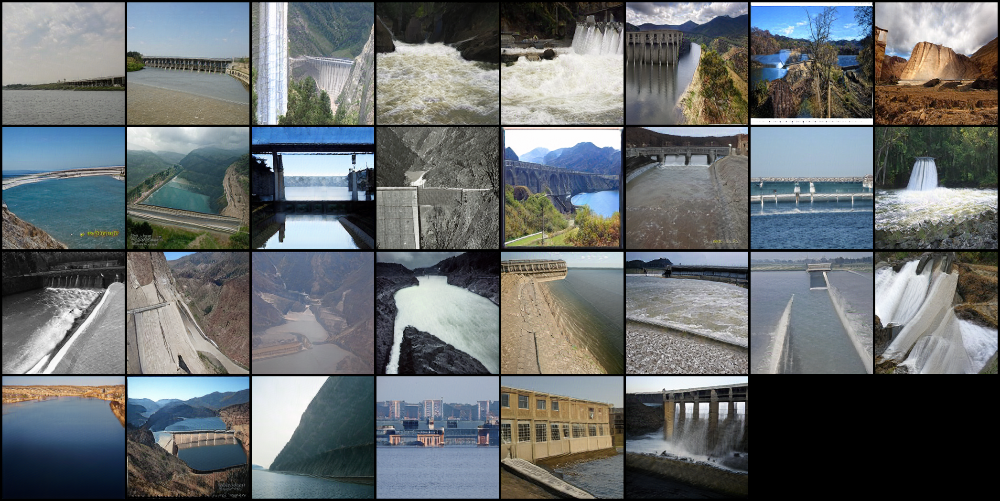

In [0]:
 z, _ = utils.prepare_z_y(batch_size, G.dim_z, n_classes, device=device, z_var=0.5)
 with torch.no_grad():
    G_z = utils.elastic_gan(g, z, y)
 vutils.visualize_samples(G_z)   #default is 15 x 15 grid 

In [0]:
!pip install imageio
import imageio

In [0]:
def create_animation(images):
  imageio.mimsave('./animation.gif', images)
  with open('./animation.gif','rb') as f:
      display.display(display.Image(data=f.read(), height=512))

In [0]:
images = G_z 
images.flatten()
create_animation(images)

ValueError: ignored

In [0]:
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


# Train an SVM on sorted z's and their labels





In [0]:
#X: size num_datapoints * num_features
#y: size num_features (with 0 and 1 as labels)
#compile X and y beforehand. X is 30 x 119 
import torch.nn as nn
X = z
y = torch.tensor([0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1]).cuda()
#y = torch.tensor([1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1]).cuda()
num_features = 119
n_iterations = 50000
model = nn.Linear(num_features, 1).cuda()                                             
optimizer = torch.optim.SGD(model.parameters(), lr=1e-2)
for i in range(n_iterations):
  optimizer.zero_grad()
  output = model(X).flatten()
  loss = torch.mean(torch.clamp(1 - output * (2*y-1), min=0)) # <---- This is the SVM loss
  loss.backward()
  optimizer.step()

In [0]:
model_save_name = 'SVM_summerlakes'
path = F"/content/gdrive/My Drive/{model_save_name}" 
torch.save(model, path)

# Now we try running the optimization loop where we're using the trained SVM to optimize. 


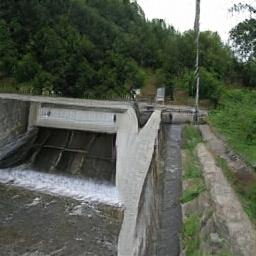

In [0]:
#let's make a z that's only 1 image
batch_size = 1
orig_class = 113
z, _ = utils.prepare_z_y(batch_size, G.dim_z, n_classes, device=device, z_var=0.5)
old_z = z.clone()
#visualize starting point 
y = orig_class * torch.ones(batch_size, device=device).long()
G_z = utils.elastic_gan(g, z, y)  # Allows for batches larger than what fits in memory.  
vutils.visualize_samples(G_z)   #default is 15 x 15 grid 

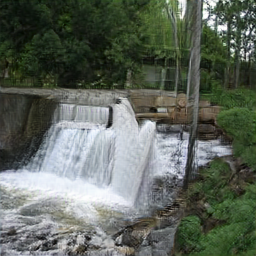

In [0]:
current_z = torch.nn.Parameter(z, requires_grad=True)   #makes space to hold gradients - z is the kind of thing we can optimize   
parameters = [current_z]   #yes we are still shifting z, this time based on the SVM value. 
num_steps =30  #sure
target_id = 152     #shouldnt' have this anymore 
target_class = target_id * torch.ones(batch_size, device=device).long()   #shouldn't have this anymore either 

optimizer = torch.optim.Adam([current_z])    #load optimizer; try Adam first 

loss_fn = torch.nn.CrossEntropyLoss(weight=None, size_average=None, ignore_index=-100, reduce=None, reduction='mean')
loss_vec= []

def elastic_gan_with_grad(model, *input):
    error_msg = 'CUDA out of memory.'

    def chunked_forward(f, *x, chunk_size=1):
        out = []
        for xcs in zip(*[xc.chunk(chunk_size) for xc in x]):
            o = f(*xcs)
            out.append(o)
        return torch.cat(out)

    cs, fit = 1, False
    while not fit:
        try:
            return chunked_forward(model, *input, chunk_size=cs)
        except RuntimeError as e:
            if error_msg in str(e):
                torch.cuda.empty_cache()
                cs *= 2
            else:
                raise e

with torch.enable_grad():
  for step_num in pbar(range(num_steps + 1)):
 
      optimizer.zero_grad()
      #current_x = elastic_gan_with_grad(g, current_z, y)   #generate current image 
      #current_x = renormalize.as_tensor(current_x, source='zc', target='imagenet')
      outputs = model(current_z)    #now this is SVM 
      loss = -model(current_z)#loss_fn(outputs,target_class)                                                      - model makes (model go towards 1s), + model makes it go toward 0 class 
      loss_vec.append(loss)
      loss.backward()     # compute the gradient here 
      optimizer.step()    #it knows to update z because z was parameter when optimizer was called 

G_z2 = utils.elastic_gan(g, current_z, y)  # Allows for batches larger than what fits in memory.  
vutils.visualize_samples(G_z2)     #see modified image 

In [0]:
model(current_z)

tensor([[35.3980]], device='cuda:0', grad_fn=<AddmmBackward>)

# Here is everything using VGG-16

In [0]:
import torchvision, os, collections
def load_vgg16(domain='places'):
    assert domain == 'places'
    model = torchvision.models.vgg16(num_classes=365)
    model.features = torch.nn.Sequential(collections.OrderedDict(zip([
        'conv1_1', 'relu1_1',
        'conv1_2', 'relu1_2',
        'pool1',
        'conv2_1', 'relu2_1',
        'conv2_2', 'relu2_2',
        'pool2',
        'conv3_1', 'relu3_1',
        'conv3_2', 'relu3_2',
        'conv3_3', 'relu3_3',
        'pool3',
        'conv4_1', 'relu4_1',
        'conv4_2', 'relu4_2',
        'conv4_3', 'relu4_3',
        'pool4',
        'conv5_1', 'relu5_1',
        'conv5_2', 'relu5_2',
        'conv5_3', 'relu5_3',
        'pool5'],
        model.features)))        
    model.classifier = torch.nn.Sequential(collections.OrderedDict(zip([
        'fc6', 'relu6',
        'drop6',
        'fc7', 'relu7',
        'drop7',
        'fc8a'],
        model.classifier)))
    baseurl = 'http://gandissect.csail.mit.edu/models/'
    url = baseurl + 'vgg16_places365-6e38b568.pth'
    try:
        sd = torch.hub.load_state_dict_from_url(url) # pytorch 1.1
    except:
        sd = torch.hub.model_zoo.load_url(url) # pytorch 1.0

    model.load_state_dict(sd)
    model.eval()
    return model

In [0]:
model = load_vgg16(domain='places')


Downloading: "http://gandissect.csail.mit.edu/models/vgg16_places365-6e38b568.pth" to /root/.cache/torch/checkpoints/vgg16_places365-6e38b568.pth


In [0]:
print(model)

VGG(
  (features): Sequential(
    (conv1_1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu1_1): ReLU(inplace=True)
    (conv1_2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu1_2): ReLU(inplace=True)
    (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv2_1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu2_1): ReLU(inplace=True)
    (conv2_2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu2_2): ReLU(inplace=True)
    (pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv3_1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu3_1): ReLU(inplace=True)
    (conv3_2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu3_2): ReLU(inplace=True)
    (conv3_3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu3_3):

In [0]:
x = torch.zeros(4,3,200,200) #data
x = model.features(x)
x = model.avgpool(x)
x = torch.flatten(x, 1)
x = model.classifier(x)
print(x.shape)

torch.Size([4, 365])


f.shapeNow run VGG16 on (unmodified) output of BigGAN Places: 

In [0]:
!git clone https://github.com/SIDN-IAP/global-model-repr.git

Cloning into 'global-model-repr'...
remote: Enumerating objects: 297, done.
remote: Counting objects: 100% (297/297), done.
remote: Compressing objects: 100% (216/216), done.
remote: Total 297 (delta 146), reused 217 (delta 79), pack-reused 0
Receiving objects: 100% (297/297), 1.20 MiB | 3.54 MiB/s, done.
Resolving deltas: 100% (146/146), done.


In [0]:
cd global-model-repr/

/content/pretorched-x/global-model-repr


In [0]:

from netdissect import nethook, imgviz, show, segmenter, renormalize, upsample, tally, pbar
from netdissect import setting

Here is example on real places data: 

Extracting datasets/places_val.zip to datasets



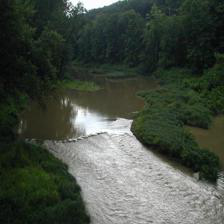

RuntimeError: ignored

In [0]:
ds = setting.load_dataset('places', 'val')
iv = imgviz.ImageVisualizer(224, source=ds, percent_level=0.99)
show(iv.image(ds[0][0]))
model = nethook.InstrumentedModel(model)
model.cuda()
renorm = renormalize.renormalizer(source=ds, target='zc')
ivsmall = imgviz.ImageVisualizer((56, 56), source=ds, percent_level=0.99)
#target_class = ds.classes.index('soccer_field')
#print(target_class)
indexes = range(317)
batch = torch.stack([ds[i][0] for i in indexes])
_, preds = model(batch.cuda()).max(1)
show([[
    iv.image(batch[j]),
    'label: ' + ds.classes[ds[i][1]],
    'pred: ' + ds.classes[preds[j]],
    i,
] for j, i in enumerate(indexes)])

In [0]:
# torch.cuda.empty_cache() 

Now try classification on the generated images: 

In [0]:
from netdissect import renormalize
model = nethook.InstrumentedModel(model)
model.cuda()
batch = renormalize.as_tensor(G_z, source='zc', target='imagenet')
_, preds = model(batch.cuda()).max(1)    #run the classification model on the batch


In [0]:
output = model(batch.cuda())
print(output)

tensor([[ 0.5629, -0.6512, -0.3121,  ...,  0.7592, -0.6420,  2.1318],
        [-0.4805, -2.1524, -0.6753,  ...,  1.6556, -0.7169,  0.3754],
        [ 0.1606, -1.3377, -0.8060,  ...,  3.3629, -1.8905,  1.3536],
        ...,
        [-0.6769, -1.3628, -0.9769,  ...,  2.0353, -0.5123, -0.3475],
        [-0.7617, -1.6804, -0.7907,  ...,  2.3174, -0.8670,  0.7326],
        [ 0.3599, -1.4083, -0.6908,  ...,  1.5105, -1.2976,  0.7769]],
       device='cuda:0', grad_fn=<AddmmBackward>)


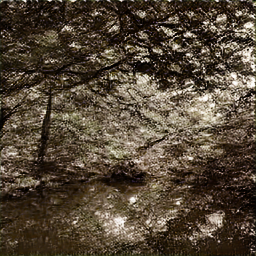

In [0]:
renormalize.as_image(batch[2], source='imagenet')

In [0]:
ds = setting.load_dataset('places', 'val')

Extracting datasets/places_val.zip to datasets



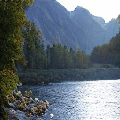
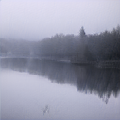
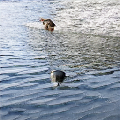
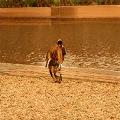
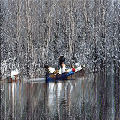
...
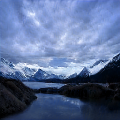
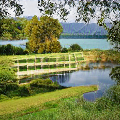
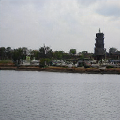
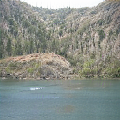
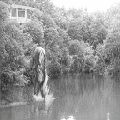

In [0]:
iv = imgviz.ImageVisualizer(120)
show([[
    iv.image(G_z[j]),
    'pred: ' + ds.classes[preds[j]],
    j,
] for j in range(0,20)])



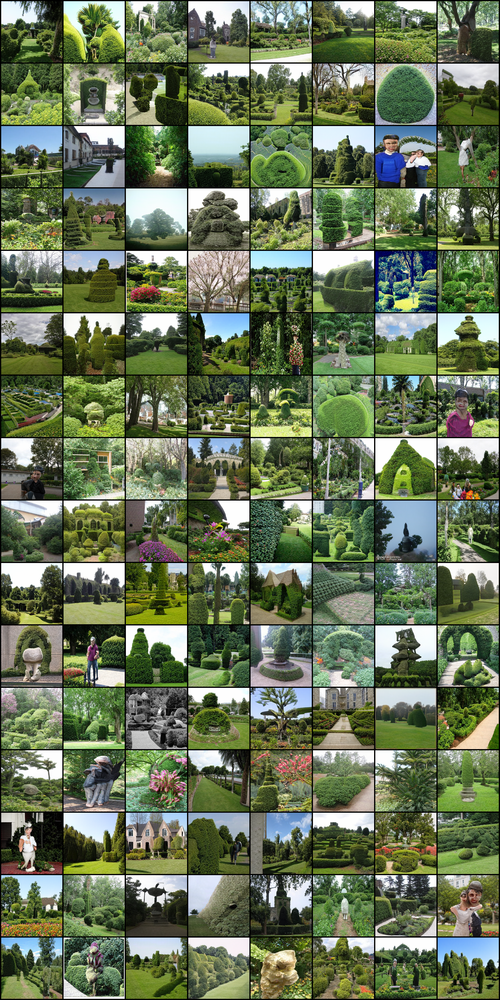

In [0]:
vutils.visualize_samples(G_z)

now we're going to try on all of the classes and see which have the best classifier performance. 



In [0]:
batch_size= 20
all_acc = []
for class_idx in range(0,365):
  y = class_idx * torch.ones(batch_size, device=device).long()

  with torch.no_grad():
      G_z = utils.elastic_gan(g, z, y)  # Allows for batches larger than what fits in memory.  
  batch = renormalize.as_tensor(G_z, source='zc', target='imagenet')
  _, preds = model(batch.cuda()).max(1)    #run the classification model on the batch 
  predsacc= []
  for j in range(0,batch_size):
    if preds[j] == class_idx:
      predsacc.append(1)
  s = sum(predsacc)
  class_acc = s/batch_size
  all_acc.append(class_acc)
print(batch_size)
print(all_acc)


  


# batch_size = 1
# for class_idx in range(0,5):
#   y = class_idx * torch.ones(batch_size, device=device).long()

#   with torch.no_grad():
#       G_z = utils.elastic_gan(g, z, y)  # Allows for batches larger than what fits in memory.  
#   batch = renormalize.as_tensor(G_z, source='zc', target='imagenet')
#   #preds = torch.nn.Softmax(model(batch.cuda()))  #run the classification model on the batch 
#   preds = torch.nn.Softmax(model(batch.cuda()))
     
#   print(class_idx)
#   print(preds)
#   print('--------')



RuntimeError: ignored

<BarContainer object of 365 artists>

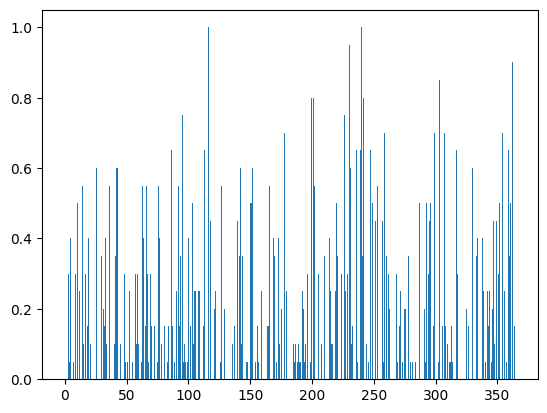

In [0]:
import matplotlib.pyplot as plt; plt.rcdefaults()
import numpy as np
import matplotlib.pyplot as plt
xvec = range(0,365)
plt.bar(xvec, all_acc)




the only classes with 100% accuracy are desert sand and nurseries 


**Now we're going to try optimizing z to shift the generated imagery into a different classification category.**



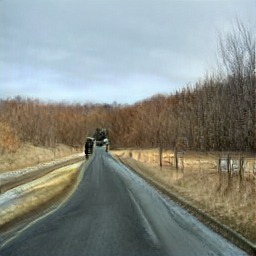

In [0]:
#let's make a z that's only 1 image
batch_size = 1
orig_class = 142
z, _ = utils.prepare_z_y(batch_size, G.dim_z, n_classes, device=device, z_var=0.5)

#visualize starting point 
y = orig_class * torch.ones(batch_size, device=device).long()
G_z = utils.elastic_gan(g, z, y)  # Allows for batches larger than what fits in memory.  
vutils.visualize_samples(G_z)   #default is 15 x 15 grid 

In [0]:


current_z = torch.nn.Parameter(z, requires_grad=True)   #makes space to hold gradients - z is the kind of thing we can optimize    
parameters = [current_z]
num_steps = 5000
target_id = 152
target_class = target_id * torch.ones(batch_size, device=device).long()

optimizer = torch.optim.Adam([current_z])    #load optimizer; try Adam first 

loss_fn = torch.nn.CrossEntropyLoss(weight=None, size_average=None, ignore_index=-100, reduce=None, reduction='mean')
loss_vec= []

def elastic_gan_with_grad(model, *input):
    error_msg = 'CUDA out of memory.'

    def chunked_forward(f, *x, chunk_size=1):
        out = []
        for xcs in zip(*[xc.chunk(chunk_size) for xc in x]):
            o = f(*xcs)
            out.append(o)
        return torch.cat(out)

    cs, fit = 1, False
    while not fit:
        try:
            return chunked_forward(model, *input, chunk_size=cs)
        except RuntimeError as e:
            if error_msg in str(e):
                torch.cuda.empty_cache()
                cs *= 2
            else:
                raise e

with torch.enable_grad():
  for step_num in pbar(range(num_steps + 1)):
      optimizer.zero_grad()
      current_x = elastic_gan_with_grad(g, current_z, y)   #generate current image 
      current_x = renormalize.as_tensor(current_x, source='zc', target='imagenet')
      outputs = model(current_x)    #run current, normalized x through VGG-16     CHANGE MODEL HERE 
      loss = loss_fn(outputs,target_class)
      loss_vec.append(loss)
      loss.backward()     # compute the gradient here 
      optimizer.step()    #it knows to update z because z was parameter when optimizer was called 

G_z2 = utils.elastic_gan(g, current_z, y)  # Allows for batches larger than what fits in memory.  
vutils.visualize_samples(G_z2)   


NameError: ignored

In [0]:
HIStorch.set_printoptions(profile="full")
print(*loss_vec, sep = "\n") 

Streaming output truncated to the last 5000 lines.
tensor(4.6115, device='cuda:0', grad_fn=<NllLossBackward>)
tensor(4.5579, device='cuda:0', grad_fn=<NllLossBackward>)
tensor(4.5040, device='cuda:0', grad_fn=<NllLossBackward>)
tensor(4.4511, device='cuda:0', grad_fn=<NllLossBackward>)
tensor(4.3999, device='cuda:0', grad_fn=<NllLossBackward>)
tensor(4.3506, device='cuda:0', grad_fn=<NllLossBackward>)
tensor(4.3001, device='cuda:0', grad_fn=<NllLossBackward>)
tensor(4.2522, device='cuda:0', grad_fn=<NllLossBackward>)
tensor(4.2057, device='cuda:0', grad_fn=<NllLossBackward>)
tensor(4.1599, device='cuda:0', grad_fn=<NllLossBackward>)
tensor(4.1156, device='cuda:0', grad_fn=<NllLossBackward>)
tensor(4.0727, device='cuda:0', grad_fn=<NllLossBackward>)
tensor(4.0327, device='cuda:0', grad_fn=<NllLossBackward>)
tensor(3.9955, device='cuda:0', grad_fn=<NllLossBackward>)
tensor(3.9590, device='cuda:0', grad_fn=<NllLossBackward>)
tensor(3.9246, device='cuda:0', grad_fn=<NllLossBackward>)
tenso

Now try running the classifier to drive layer activation instead of z. 


In [0]:
!git clone https://github.com/davidbau/gpwidget -b demo gpwidget 2>> install.log
import sys
sys.path.append('/content/gpwidget')

In [0]:
#extract the layer you are going to optimize from G
probe_layer = 'layer8'      #pick which layer you're going to change 
G.retain_layers([probe_layer])
optim_layer =  G.retained_layer(probe_layer).clone()
optim_layer = torch.nn.Parameter(optim_layer, requires_grad=True)   #makes space to hold gradients - z is the kind of thing we can optimize    
parameters = [optim_layer]

num_steps = 5000
target_id = 152
target_class = target_id * torch.ones(batch_size, device=device).long()

optimizer = torch.optim.Adam([optim_layer])    #load optimizer; try Adam first 

loss_fn = torch.nn.CrossEntropyLoss(weight=None, size_average=None, ignore_index=-100, reduce=None, reduction='mean')
loss_vec= []

def elastic_gan_with_grad(model, *input):
    error_msg = 'CUDA out of memory.'

    def chunked_forward(f, *x, chunk_size=1):
        out = []
        for xcs in zip(*[xc.chunk(chunk_size) for xc in x]):
            o = f(*xcs)
            out.append(o)
        return torch.cat(out)

    cs, fit = 1, False
    while not fit:
        try:
            return chunked_forward(model, *input, chunk_size=cs)
        except RuntimeError as e:
            if error_msg in str(e):
                torch.cuda.empty_cache()
                cs *= 2
            else:
                raise e

def optim_update(x, *args):
  x[:] = optim_layer    #replace those layer values with optimized layer values 
return x

with torch.enable_grad():
  for step_num in pbar(range(num_steps + 1)):
      optimizer.zero_grad()
      current_x = elastic_gan_with_grad(g, z, y)   #generate current image 
      current_x = renormalize.as_tensor(current_x, source='zc', target='imagenet')
      outputs = model(current_x)    #run current, normalized x through VGG-16 
      loss = loss_fn(outputs,target_class)
      loss_vec.append(loss)
      loss.backward()     # compute the gradient here 
      optimizer.step()    #it knows to update z because z was parameter when optimizer was called 
      G.edit_layer(probe_layer, rule=optim_update)
      G.retain_layers([probe_layer])
      g = functools.partial(G, embed=True)
      


G_z2 = utils.elastic_gan(g, current_z, y)  # Allows for batches larger than what fits in memory.  
vutils.visualize_samples(G_z2)   

AttributeError: ignored

In [0]:
G




Generator(
  (activation): ReLU(inplace=True)
  (shared): Embedding(365, 128)
  (linear): SNLinear(in_features=17, out_features=32768, bias=True)
  (blocks): ModuleList(
    (0): ModuleList(
      (0): GBlock(
        (activation): ReLU(inplace=True)
        (conv1): SNConv2d(2048, 2048, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (conv2): SNConv2d(2048, 2048, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (conv_sc): SNConv2d(2048, 2048, kernel_size=(1, 1), stride=(1, 1))
        (bn1): ccbn(
          out: 2048, in: 145, cross_replica=False
          (gain): SNLinear(in_features=145, out_features=2048, bias=False)
          (bias): SNLinear(in_features=145, out_features=2048, bias=False)
        )
        (bn2): ccbn(
          out: 2048, in: 145, cross_replica=False
          (gain): SNLinear(in_features=145, out_features=2048, bias=False)
          (bias): SNLinear(in_features=145, out_features=2048, bias=False)
        )
      )
    )
    (1): ModuleList(